<a href="https://colab.research.google.com/github/AbhishekSimkar/Brinell_Hardness_prediction/blob/main/Brinell_hardness_ML_prediction_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
from math import sqrt
import numpy as np
import pickle
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

In [2]:
df=pd.read_excel('Materials_property_data_new.xlsx')

# Data Pre-processing

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1105 entries, 0 to 1104
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0                       1105 non-null   int64  
 1   Material Name                    1105 non-null   object 
 2   Yield Tensile Strength(MPa)      1105 non-null   float64
 3   Ultimate Tensile Strength (MPa)  1102 non-null   float64
 4   Modulus of Elasticity (GPa)      1089 non-null   float64
 5   Elongation (%)                   1100 non-null   float64
 6   Melting Point (°C)               1105 non-null   float64
 7   Density (g/cc)                   1104 non-null   float64
 8   Specific Heat Capacity (J/g-°C)  1017 non-null   float64
 9   Electrical Resistivity (ohm-cm)  1040 non-null   float64
 10  Thermal Conductivity (W/m-K)     1053 non-null   float64
 11  Brinell Hardness                 1105 non-null   float64
dtypes: float64(10), int6

In [4]:
df.isnull().sum()

Unnamed: 0                          0
Material Name                       0
Yield Tensile Strength(MPa)         0
Ultimate Tensile Strength (MPa)     3
Modulus of Elasticity (GPa)        16
Elongation (%)                      5
Melting Point (°C)                  0
Density (g/cc)                      1
Specific Heat Capacity (J/g-°C)    88
Electrical Resistivity (ohm-cm)    65
Thermal Conductivity (W/m-K)       52
Brinell Hardness                    0
dtype: int64

In [5]:
df1=df[['Yield Tensile Strength(MPa)','Ultimate Tensile Strength (MPa)', 'Modulus of Elasticity (GPa)','Elongation (%)', 'Melting Point (°C)', 'Density (g/cc)','Electrical Resistivity (ohm-cm)', 'Specific Heat Capacity (J/g-°C)','Thermal Conductivity (W/m-K)', 'Brinell Hardness ']]

In [6]:
df1.head()

,Yield Tensile Strength(MPa),Ultimate Tensile Strength (MPa),Modulus of Elasticity (GPa),Elongation (%),Melting Point (°C),Density (g/cc),Electrical Resistivity (ohm-cm),Specific Heat Capacity (J/g-°C),Thermal Conductivity (W/m-K),Brinell Hardness
0,13.7,40.0,23.4,52.0,838.0,1.54,0.000005,0.632,126.0,17.0
1,225.0,1830.0,211.0,30.0,1490.0,8.80,0.000006,0.440,69.2,125.0
2,362.0,413.0,248.0,44.0,1860.0,7.19,0.000013,0.461,69.1,125.0
3,50.0,540.0,200.0,18.0,1540.0,7.87,0.000009,0.440,76.2,146.0
4,21.0,90.0,44.0,4.0,648.0,1.74,0.000005,1.020,159.0,30.0


In [7]:
df1.dropna(inplace=True)

<ipython-input-7-e0e758ddcf8a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.dropna(inplace=True)


In [8]:
df1.drop_duplicates(inplace=True)

<ipython-input-8-1788250b656d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)


In [9]:
df1.shape

(910, 10)

In [10]:
df1.head()

,Yield Tensile Strength(MPa),Ultimate Tensile Strength (MPa),Modulus of Elasticity (GPa),Elongation (%),Melting Point (°C),Density (g/cc),Electrical Resistivity (ohm-cm),Specific Heat Capacity (J/g-°C),Thermal Conductivity (W/m-K),Brinell Hardness
0,13.7,40.0,23.4,52.0,838.0,1.54,0.000005,0.632,126.0,17.0
1,225.0,1830.0,211.0,30.0,1490.0,8.80,0.000006,0.440,69.2,125.0
2,362.0,413.0,248.0,44.0,1860.0,7.19,0.000013,0.461,69.1,125.0
3,50.0,540.0,200.0,18.0,1540.0,7.87,0.000009,0.440,76.2,146.0
4,21.0,90.0,44.0,4.0,648.0,1.74,0.000005,1.020,159.0,30.0


In [11]:
df1.corr()

,Yield Tensile Strength(MPa),Ultimate Tensile Strength (MPa),Modulus of Elasticity (GPa),Elongation (%),Melting Point (°C),Density (g/cc),Electrical Resistivity (ohm-cm),Specific Heat Capacity (J/g-°C),Thermal Conductivity (W/m-K),Brinell Hardness
Yield Tensile Strength(MPa),1.000000,0.934423,0.608438,-0.014101,0.629448,0.412056,0.724528,-0.461396,-0.500646,0.923836
Ultimate Tensile Strength (MPa),0.934423,1.000000,0.767669,0.214025,0.724858,0.580778,0.780311,-0.598499,-0.633069,0.935843
Modulus of Elasticity (GPa),0.608438,0.767669,1.000000,0.537272,0.874041,0.818004,0.699417,-0.752549,-0.663325,0.736855
Elongation (%),-0.014101,0.214025,0.537272,1.000000,0.459926,0.533848,0.373747,-0.548460,-0.446057,0.138229
Melting Point (°C),0.629448,0.724858,0.874041,0.459926,1.000000,0.736206,0.759444,-0.752530,-0.690731,0.756498
Density (g/cc),0.412056,0.580778,0.818004,0.533848,0.736206,1.000000,0.507860,-0.945683,-0.726320,0.539033
Electrical Resistivity (ohm-cm),0.724528,0.780311,0.699417,0.373747,0.759444,0.507860,1.000000,-0.585778,-0.683601,0.792292
Specific Heat Capacity (J/g-°C),-0.461396,-0.598499,-0.752549,-0.548460,-0.752530,-0.945683,-0.585778,1.000000,0.767839,-0.578276
Thermal Conductivity (W/m-K),-0.500646,-0.633069,-0.663325,-0.446057,-0.690731,-0.726320,-0.683601,0.767839,1.000000,-0.623343
Brinell Hardness,0.923836,0.935843,0.736855,0.138229,0.756498,0.539033,0.792292,-0.578276,-0.623343,1.000000


In [12]:
!pip install ydata_profiling

In [13]:
from ydata_profiling import ProfileReport

In [14]:
ProfileReport(df1)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Feature selection and feature scaling

In [15]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, roc_curve, roc_auc_score
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [16]:
df1.columns

Index(['Yield Tensile Strength(MPa)', 'Ultimate Tensile Strength (MPa)',
       'Modulus of Elasticity (GPa)', 'Elongation (%)', 'Melting Point (°C)',
       'Density (g/cc)', 'Electrical Resistivity (ohm-cm)',
       'Specific Heat Capacity (J/g-°C)', 'Thermal Conductivity (W/m-K)',
       'Brinell Hardness '],
      dtype='object')

In [17]:
scaler= StandardScaler()

In [18]:
ProfileReport(pd.DataFrame(scaler.fit_transform(df1)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
x=df1[[ 'Ultimate Tensile Strength (MPa)', 'Modulus of Elasticity (GPa)', 'Melting Point (°C)', 'Electrical Resistivity (ohm-cm)', 'Thermal Conductivity (W/m-K)']]
y=df1['Brinell Hardness ']

In [20]:
x_scale= scaler.fit_transform(x)

In [21]:
x_train, x_test, y_train, y_test=train_test_split(x_scale,y,test_size=0.3,random_state=42)

In [22]:
x_train.shape

(637, 5)

In [23]:
x_test.shape

(273, 5)

In [24]:
y_train_array = y_train.to_numpy()

In [25]:
print(y_train_array.shape)

(637,)


# Linear Regression

In [26]:
from sklearn.linear_model import LinearRegression

In [27]:
linear=LinearRegression()

In [28]:
linear.fit(x_train,y_train)

LinearRegression()

In [29]:
linear.intercept_

144.4013276414422

In [30]:
linear.coef_

array([ 86.50137988, -15.81410136,  24.10907079,   9.65449147,
         2.36660908])

In [31]:
file1= 'Linear_regression_new.sav'
pickle.dump(linear,open(file1,'wb'))

In [32]:
y_linear=linear.predict(x_test)

In [33]:
linear.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([48.70677341])

In [34]:
linear.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([21.75714295])

In [35]:
r2_score(y_test,y_linear)

0.925003225241885

# Elastic Net Regression
(L1+L2 regularization)

In [36]:
from sklearn.linear_model import ElasticNet

In [37]:
elastic_net = ElasticNet(alpha=0.1, l1_ratio=0.5)

In [38]:
elastic_net.fit(x_train,y_train)

ElasticNet(alpha=0.1)

In [39]:
elastic_net.intercept_

144.57077897485368

In [40]:
elastic_net.coef_

array([74.17633972, -5.25178271, 18.07138884, 14.32172362,  0.49194648])

In [41]:
y_elastic_net=elastic_net.predict(x_test)

In [42]:
elastic_net.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([53.75031819])

In [43]:
elastic_net.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([34.25081845])

In [44]:
r2_score(y_test,y_elastic_net)

0.9209618393524787

# K Nearest Neighbor Regressor

In [45]:
from sklearn.neighbors import KNeighborsRegressor

In [46]:
knn= KNeighborsRegressor(n_neighbors=5)

In [47]:
knn.fit(x_train,y_train)

KNeighborsRegressor()

In [48]:
y5_knn=knn.predict(x_test)

In [49]:
r2_score(y_test,y5_knn)

0.9566325633763272

In [95]:
from sklearn import neighbors
R2_val = [] #to store R squirred values for different k
for K in range(1,10):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(x_train, y_train)  #fit the model
    pred=model.predict(x_test) #make prediction on test set
    error = r2_score(y_test,pred) #calculate R2
    R2_val.append(error) #store R2 values
    print('R squared value for k= ' , K , 'is:', error)

R squared value for k=  2 is: 0.9510263435257105
R squared value for k=  3 is: 0.9560126733621418
R squared value for k=  4 is: 0.9582153058034246
R squared value for k=  5 is: 0.9566325633763272
R squared value for k=  6 is: 0.9539790409635105
R squared value for k=  7 is: 0.9500026282507161
R squared value for k=  8 is: 0.9470507695367182
R squared value for k=  9 is: 0.9452917407014132
R squared value for k=  10 is: 0.9445232300415085


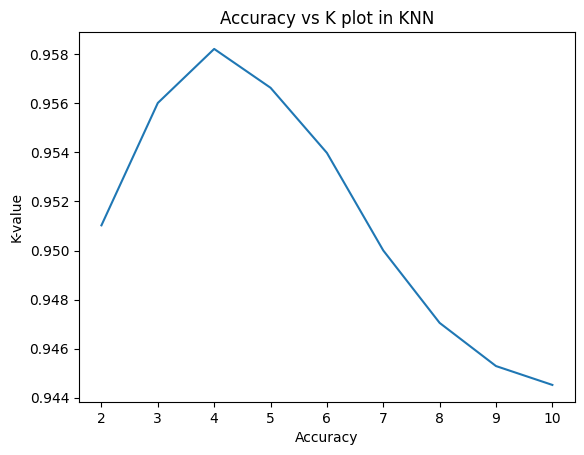

In [96]:
x=[]
for K in range(2,11):
  x.append(K)

y= R2_val
plt.plot(x,y)
plt.xlabel("Accuracy")
plt.ylabel("K-value")
plt.title("Accuracy vs K plot in KNN")
plt.show()

R-Squared value of K-Nearest Neighbor is highest for K=4 and equal to 0.9582153058034246.

In [52]:
knn_optimised= KNeighborsRegressor(n_neighbors=4)

In [53]:
knn_optimised.fit(x_train,y_train)

KNeighborsRegressor(n_neighbors=4)

In [54]:
knn_optimised.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([56.25])

In [55]:
knn_optimised.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([59.25])

# Decision Tree Regression

In [56]:
from sklearn.tree import DecisionTreeRegressor
tree_reg = DecisionTreeRegressor(criterion='poisson',splitter='random',random_state=42)
tree_reg.fit(x_train, y_train)

DecisionTreeRegressor(criterion='poisson', random_state=42, splitter='random')

In [57]:
y_tree=tree_reg.predict(x_test)

In [58]:
tree_reg.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([55.])

In [59]:
tree_reg.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([45.])

In [60]:
r2_score(y_test,y_tree)

0.9278237387383853

# Gradient Boosting Regressor

In [61]:
from sklearn.ensemble import GradientBoostingRegressor

In [62]:
gbr = GradientBoostingRegressor(max_depth=2, n_estimators=50, learning_rate=0.5)

In [63]:
gbr.fit(x_train,y_train)

GradientBoostingRegressor(learning_rate=0.5, max_depth=2, n_estimators=50)

In [64]:
gbr.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([38.77325963])

In [65]:
gbr.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([53.97921323])

In [66]:
y_gbr=gbr.predict(x_test)

In [67]:
r2_score(y_test,y_gbr)

0.9463431353213755

# Gradient Boosting Regressor
(Early stopping)

In [68]:
from sklearn.metrics import mean_squared_error

In [69]:
gbrt = GradientBoostingRegressor(max_depth=2, warm_start=True)
min_val_error = float("inf")
error_going_up = 0
for n_estimators in range(1, 120):
    gbrt.n_estimators = n_estimators
    gbrt.fit(x_train, y_train)
    y_pred = gbrt.predict(x_test)
    val_error = mean_squared_error(y_test, y_pred)
    if val_error < min_val_error:
        min_val_error = val_error
        error_going_up = 0
    else:
        error_going_up += 1
        if error_going_up == 5:
            break

In [70]:
gbrt.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([42.1105152])

In [71]:
gbrt.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([53.889097])

In [72]:
r2_score(y_test,y_pred)

0.944252698242555

# XGBoost Regression

In [73]:
import xgboost

In [74]:
xgb_reg = xgboost.XGBRegressor()

In [75]:
xgb_reg.fit(x_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [76]:
y_xgb = xgb_reg.predict(x_test)

In [77]:
xgb_reg.predict(scaler.transform([[130,50,550,0.00002,100]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([40.082508], dtype=float32)

In [78]:
xgb_reg.predict(scaler.transform([[100,80,400,0.000005,65]]))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


array([46.74862], dtype=float32)

In [79]:
r2_score(y_test,y_xgb)

0.9571810528779937

# plots

In [80]:
algo=['Linear','Elastic Net', 'KNN', 'Decision Tree', 'Gradient Boosting','Early stopping GBR', 'XGBoost']
r2=[0.92500,0.92096,0.95822,0.92782,0.94898,0.94431,0.95718]

In [81]:
import seaborn as sns

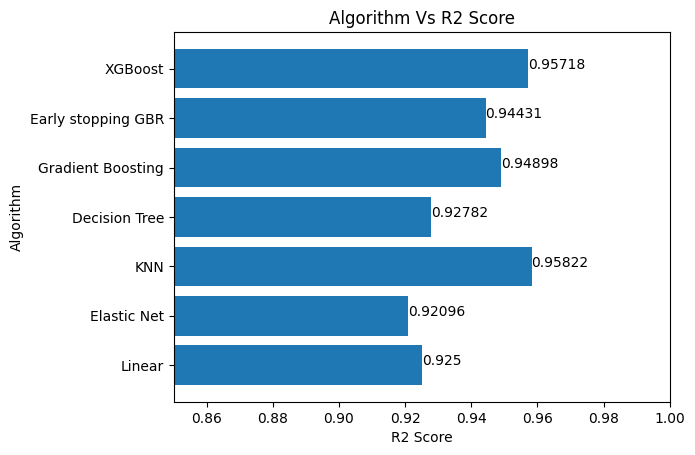

In [82]:
plt.barh(algo,r2)
plt.xlim(0.85,1)
plt.title('Algorithm Vs R2 Score')
plt.xlabel('R2 Score')
plt.ylabel('Algorithm')
for index, value in enumerate(r2):
    plt.text(value, index, str(value))
plt.show()

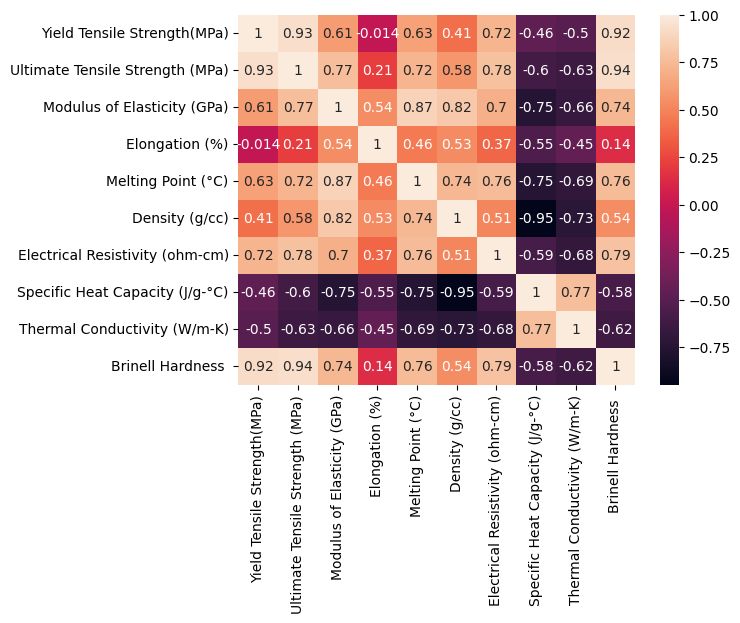

In [83]:
# Plot the correlation matrix
sns.heatmap(df1.corr(), annot=True)
plt.show()

In [84]:
a=[]
for i in range(0,551):
  a.append(i)

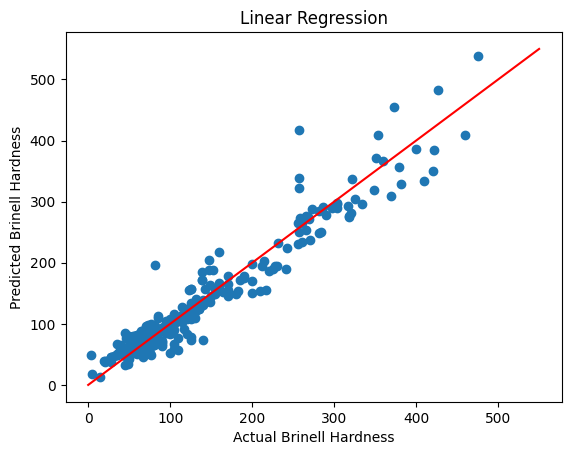

In [85]:
# Scatter plot of predicted vs actual values for Linear Regression
plt.scatter(y_test, y_linear)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("Linear Regression")
plt.show()

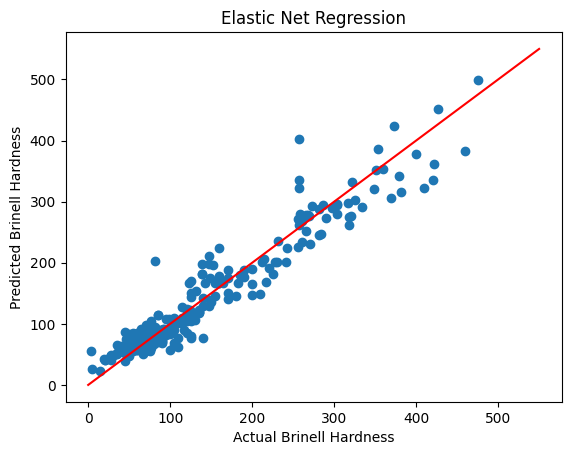

In [86]:
# Scatter plot of predicted vs actual values for Elastic Net
plt.scatter(y_test, y_elastic_net)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("Elastic Net Regression")
plt.show()

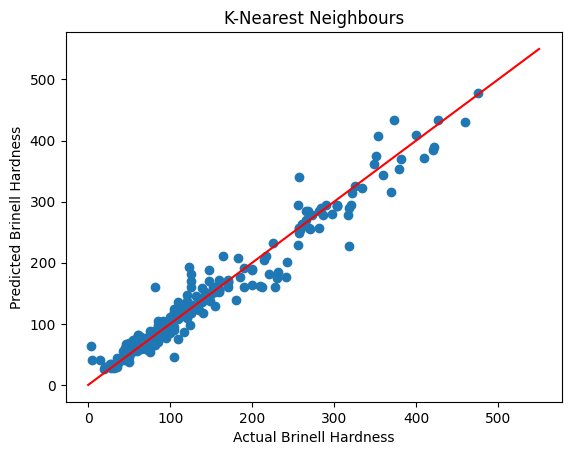

In [87]:
# Scatter plot of predicted vs actual values for KNN
plt.scatter(y_test, y5_knn)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("K-Nearest Neighbours")
plt.show()

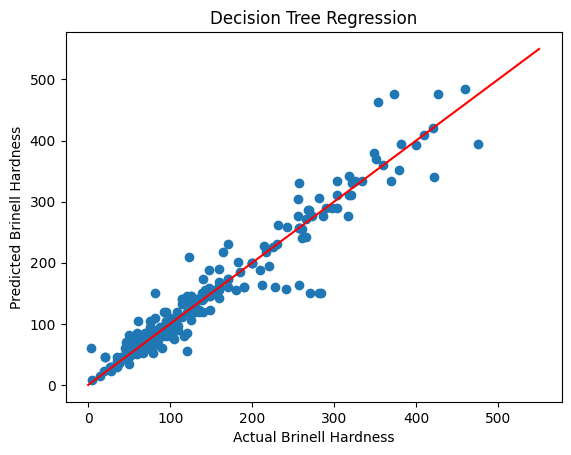

In [88]:
# Scatter plot of predicted vs actual values for Decision Tree
plt.scatter(y_test, y_tree)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("Decision Tree Regression")
plt.show()

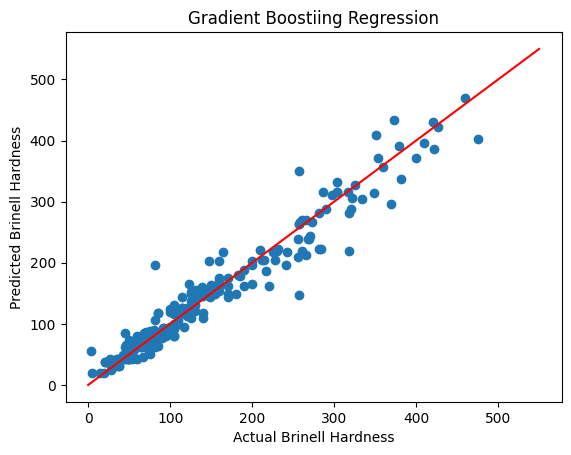

In [89]:
# Scatter plot of predicted vs actual values for Gradient Boostiing Regression
plt.scatter(y_test, y_gbr)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("Gradient Boostiing Regression")
plt.show()

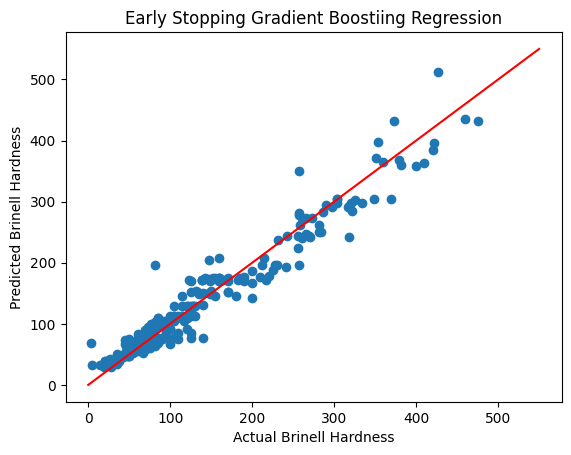

In [90]:
# Scatter plot of predicted vs actual values for Early Stopping GBR
plt.scatter(y_test, y_pred)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("Early Stopping Gradient Boostiing Regression")
plt.show()

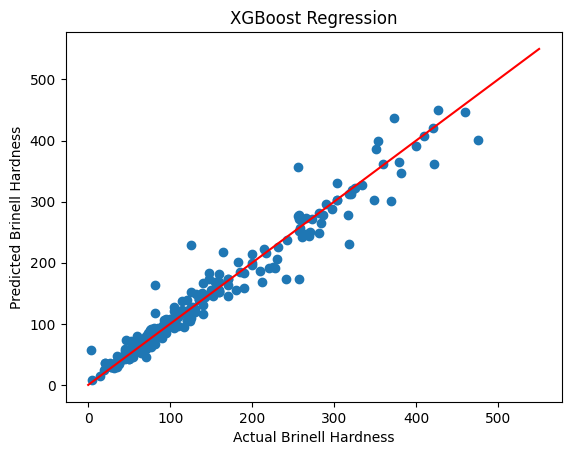

In [91]:
# Scatter plot of predicted vs actual values for XGBoost Regression
plt.scatter(y_test, y_xgb)
plt.plot(a,a,color='r')
plt.xlabel("Actual Brinell Hardness")
plt.ylabel("Predicted Brinell Hardness")
plt.title("XGBoost Regression")
plt.show()

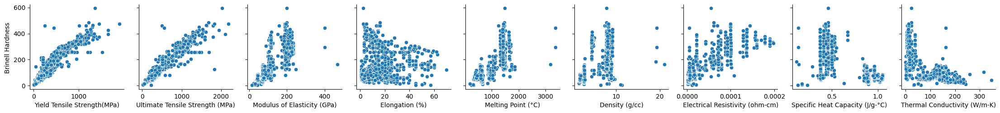

In [92]:
# Plot the relationship between Brinell Hardness and other features
sns.pairplot(df1, x_vars=['Yield Tensile Strength(MPa)', 'Ultimate Tensile Strength (MPa)','Modulus of Elasticity (GPa)', 'Elongation (%)', 'Melting Point (°C)','Density (g/cc)', 'Electrical Resistivity (ohm-cm)','Specific Heat Capacity (J/g-°C)', 'Thermal Conductivity (W/m-K)'], y_vars=['Brinell Hardness '])
plt.show()

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


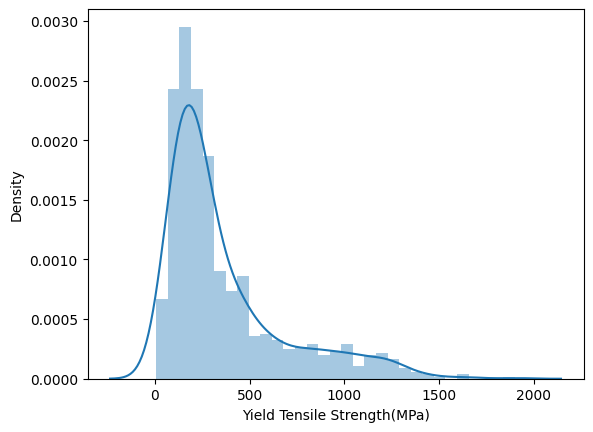

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


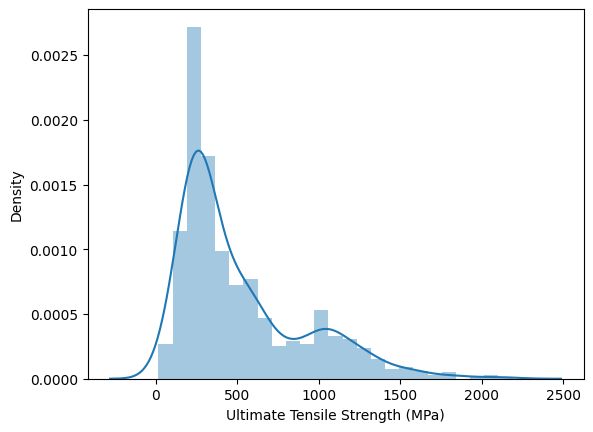

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


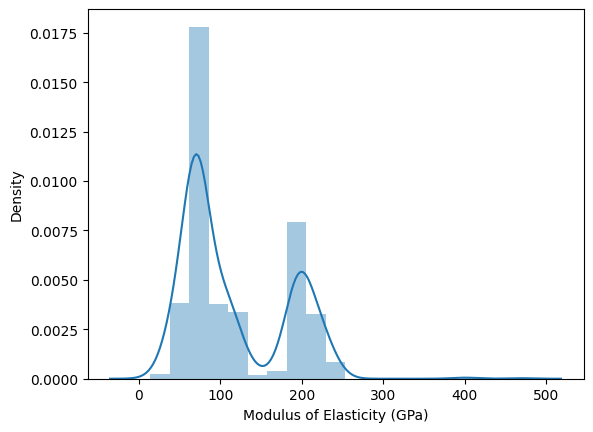

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


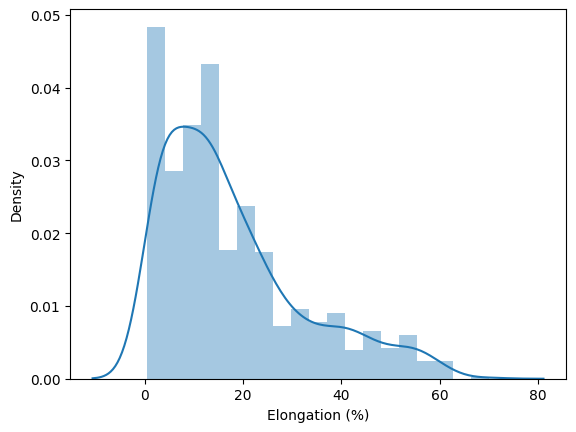

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


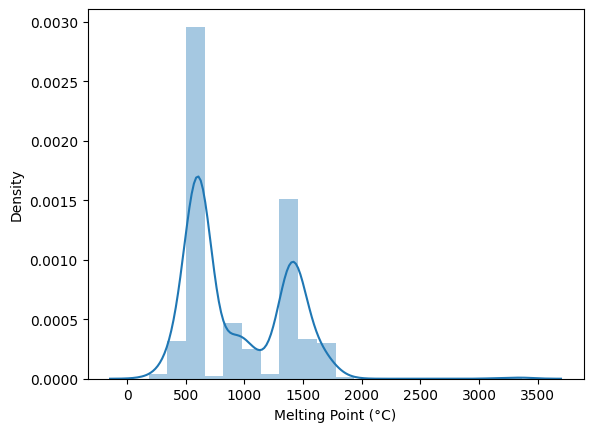

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


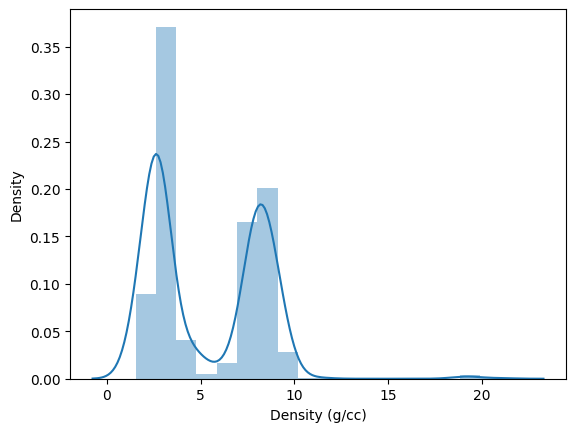

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


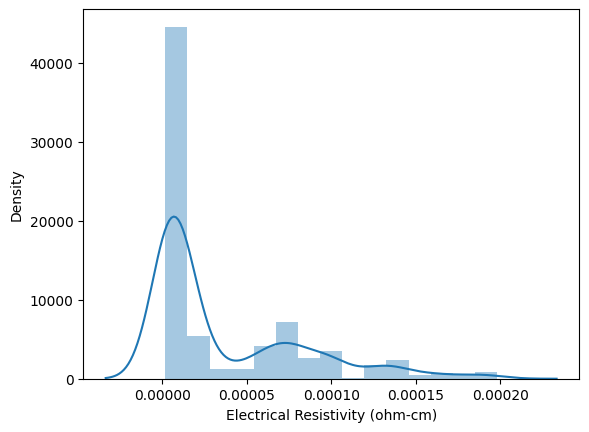

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


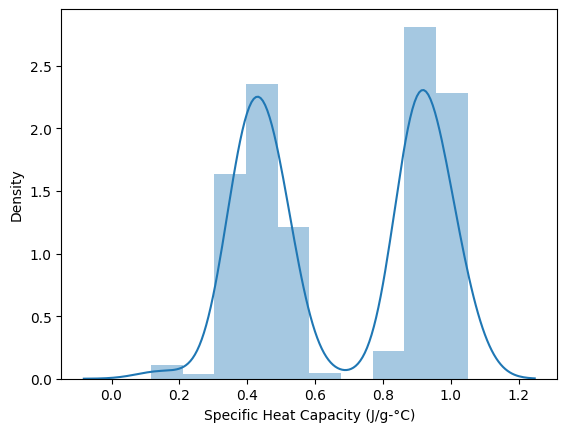

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


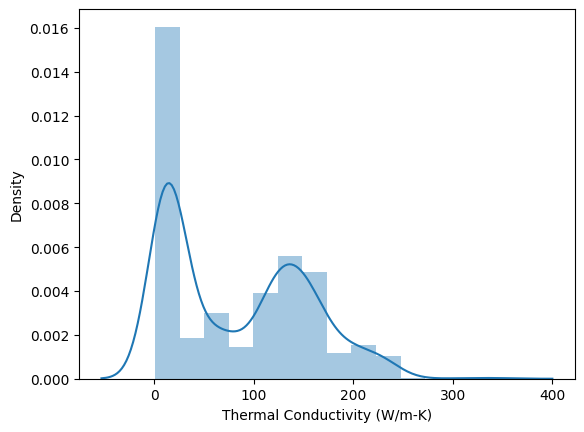

<ipython-input-93-d49078c1d5a0>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[col])


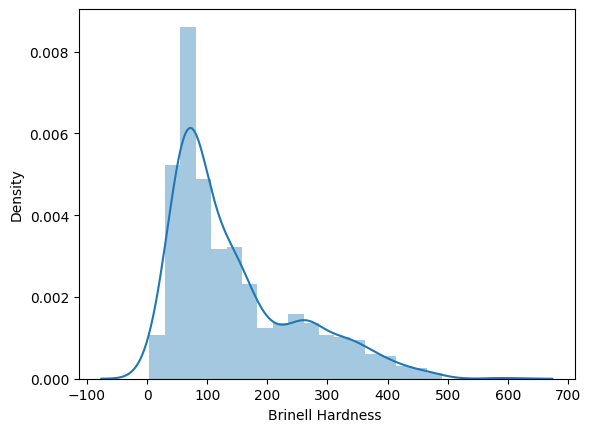

In [93]:
# Plot the distribution of each feature
for col in df1.columns:
  sns.distplot(df1[col])
  plt.show()

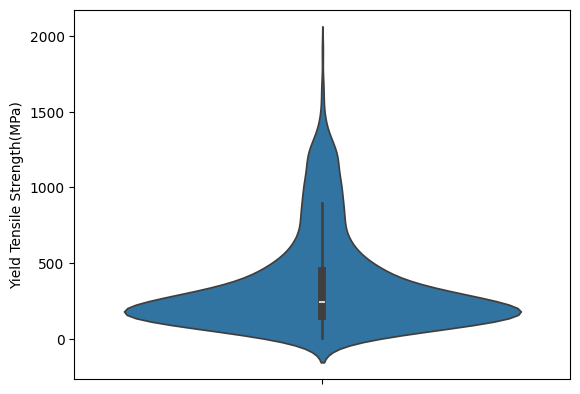

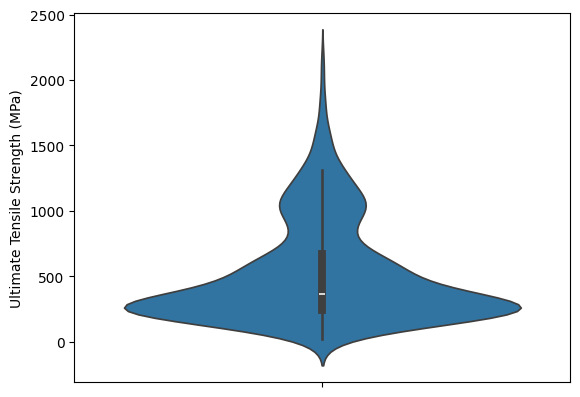

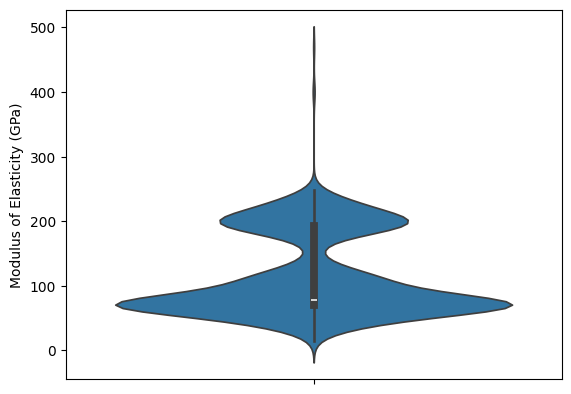

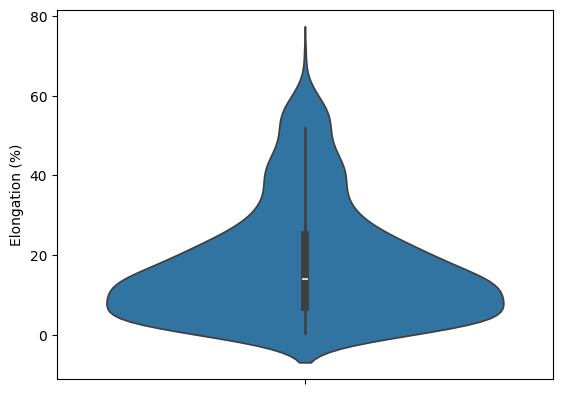

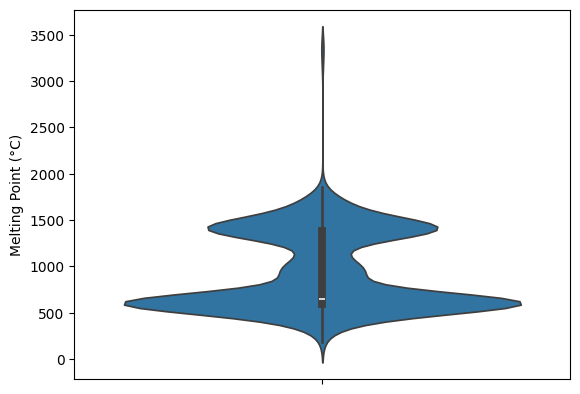

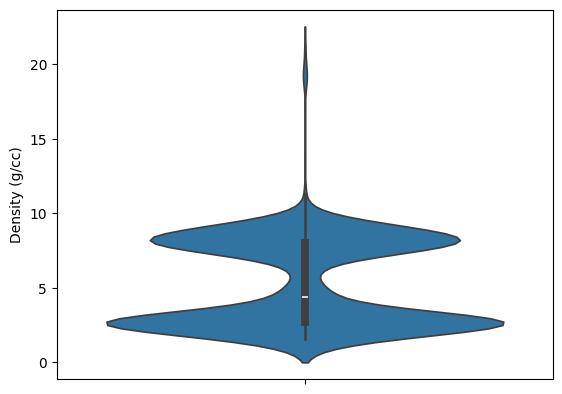

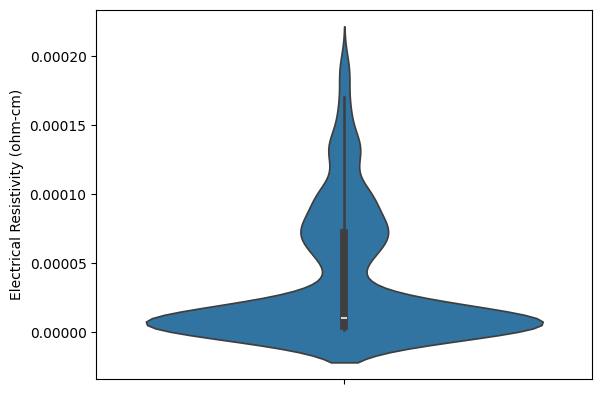

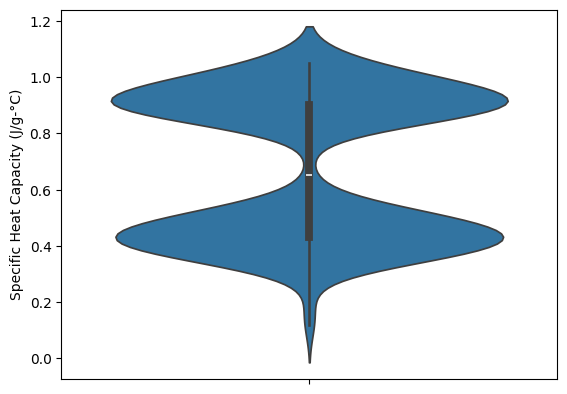

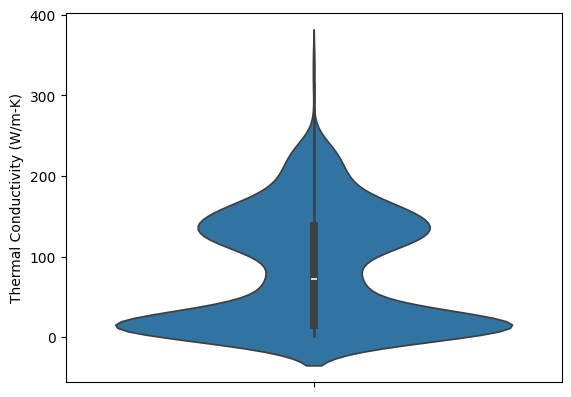

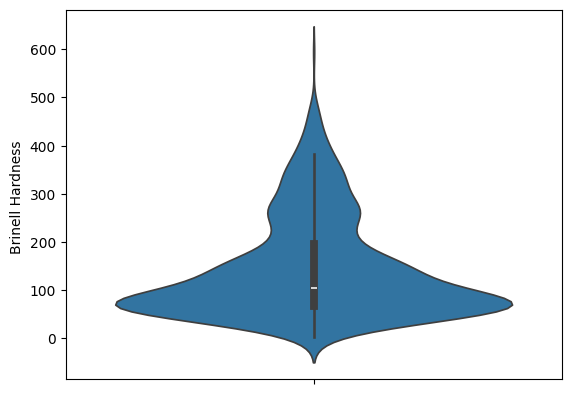

In [94]:
# draw voiline plots

import matplotlib.pyplot as plt
for col in df1.columns:
  sns.violinplot(y=df1[col])
  plt.show()
